<a href="https://colab.research.google.com/github/ShuriKimura0402/project-examples/blob/main/DogRecognize9Finalver.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install chainer
import chainer

     |████████████████████████████████| 1.0 MB 4.9 MB/s 
  Created wheel for chainer: filename=chainer-7.8.1-py3-none-any.whl size=967740 sha256=dadafddbd211627f19c6077d452ac7e8f26946881e5be12d9349f5c0cc8a350b
  Stored in directory: /root/.cache/pip/wheels/c8/6a/6f/fd563166cc597e5206e375ea074ea836e5db5dd58421215672
Successfully built chainer


In [ ]:
!pip install CuPy

     |████████████████████████████████| 1.7 MB 4.9 MB/s 
  Created wheel for CuPy: filename=cupy-10.1.0-cp37-cp37m-linux_x86_64.whl size=95182638 sha256=d81d1f623f95bf5bbabfbd3e6514e8153d23a16f8622f2fca42cbbfc109f50de
  Stored in directory: /root/.cache/pip/wheels/b9/90/cb/1c40e3f27621c39a2a90b7297030b9eec35abc5601e68963bc
Successfully built CuPy


In [ ]:
import cupy
chainer.print_runtime_info()

Platform: Linux-5.4.144+-x86_64-with-Ubuntu-18.04-bionic
Chainer: 7.8.1
ChainerX: Not Available
NumPy: 1.19.5
CuPy: Not Available
iDeep: 2.0.0.post3


In [ ]:
!pip install Pillow

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import chainer.links as L
import chainer.functions as F
from chainer import Sequential
from chainer import training, serializers, Chain, optimizers, iterators
from chainer.training import extensions, Trainer

In [ ]:
from google.colab import files
uploaded_file = files.upload()

Saving pomchan 2.zip to pomchan 2.zip


In [ ]:
!unzip pomchan\ 2.zip

Archive:  pomchan 2.zip
   creating: pomchan/
  inflating: __MACOSX/._pomchan      
  inflating: pomchan/IMG_1624.jpeg   
  inflating: __MACOSX/pomchan/._IMG_1624.jpeg  
  inflating: pomchan/IMG_0193.jpeg   
  inflating: __MACOSX/pomchan/._IMG_0193.jpeg  
  inflating: pomchan/IMG_1628.jpeg   
  inflating: __MACOSX/pomchan/._IMG_1628.jpeg  
  inflating: pomchan/IMG_0428.jpeg   
  inflating: __MACOSX/pomchan/._IMG_0428.jpeg  
  inflating: pomchan/IMG_0003.jpeg   
  inflating: __MACOSX/pomchan/._IMG_0003.jpeg  
  inflating: pomchan/IMG_0384.jpeg   
  inflating: __MACOSX/pomchan/._IMG_0384.jpeg  
  inflating: pomchan/IMG_0002.jpeg   
  inflating: __MACOSX/pomchan/._IMG_0002.jpeg  
  inflating: pomchan/IMG_1613.jpeg   
  inflating: __MACOSX/pomchan/._IMG_1613.jpeg  
  inflating: pomchan/IMG_0192.jpeg   
  inflating: __MACOSX/pomchan/._IMG_0192.jpeg  
  inflating: pomchan/IMG_1629.jpeg   
  inflating: __MACOSX/pomchan/._IMG_1629.jpeg  
  inflating: pomchan/IMG_1625.jpeg   
  inflating: __MAC

In [ ]:
ls

 __MACOSX/   pomchan/  'pomchan 2.zip'   rayychan.zip   sample_data/


In [ ]:
from google.colab import files
uploaded_file = files.upload()

Saving rayychan.zip to rayychan.zip


In [ ]:
!unzip rayychan.zip

Archive:  rayychan.zip
   creating: rayychan/
  inflating: rayychan/IMG_2225.jpeg  
  inflating: __MACOSX/rayychan/._IMG_2225.jpeg  
  inflating: rayychan/IMG_7395.jpg   
  inflating: __MACOSX/rayychan/._IMG_7395.jpg  
  inflating: rayychan/IMG_7397.jpg   
  inflating: __MACOSX/rayychan/._IMG_7397.jpg  
  inflating: rayychan/IMG_1645.jpeg  
  inflating: __MACOSX/rayychan/._IMG_1645.jpeg  
  inflating: rayychan/IMG_7396.jpg   
  inflating: __MACOSX/rayychan/._IMG_7396.jpg  
  inflating: rayychan/IMG_9776.jpeg  
  inflating: __MACOSX/rayychan/._IMG_9776.jpeg  
  inflating: rayychan/IMG_9777.jpeg  
  inflating: __MACOSX/rayychan/._IMG_9777.jpeg  
  inflating: rayychan/IMG_1898.JPG   
  inflating: __MACOSX/rayychan/._IMG_1898.JPG  
  inflating: rayychan/IMG_2269.jpeg  
  inflating: __MACOSX/rayychan/._IMG_2269.jpeg  
  inflating: rayychan/IMG_7554.jpg   
  inflating: __MACOSX/rayychan/._IMG_7554.jpg  
  inflating: rayychan/IMG_7555.jpg   
  inflating: __MACOSX/rayychan/._IMG_7555.jpg  
  i

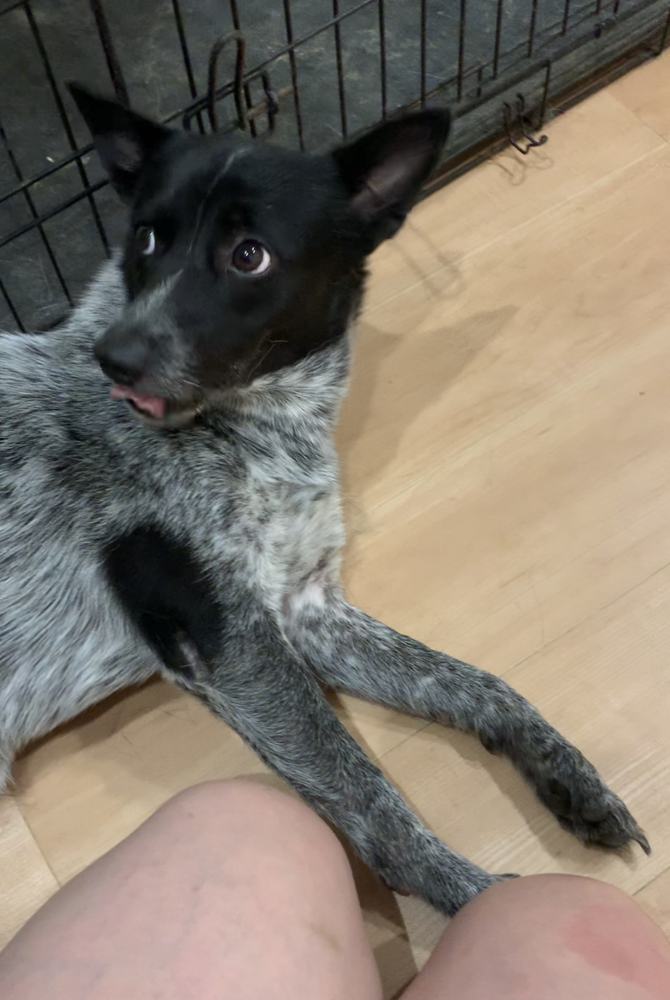

In [ ]:
from PIL import Image

train_image_path = './rayychan/IMG_7395.jpg'
Image.open(train_image_path)

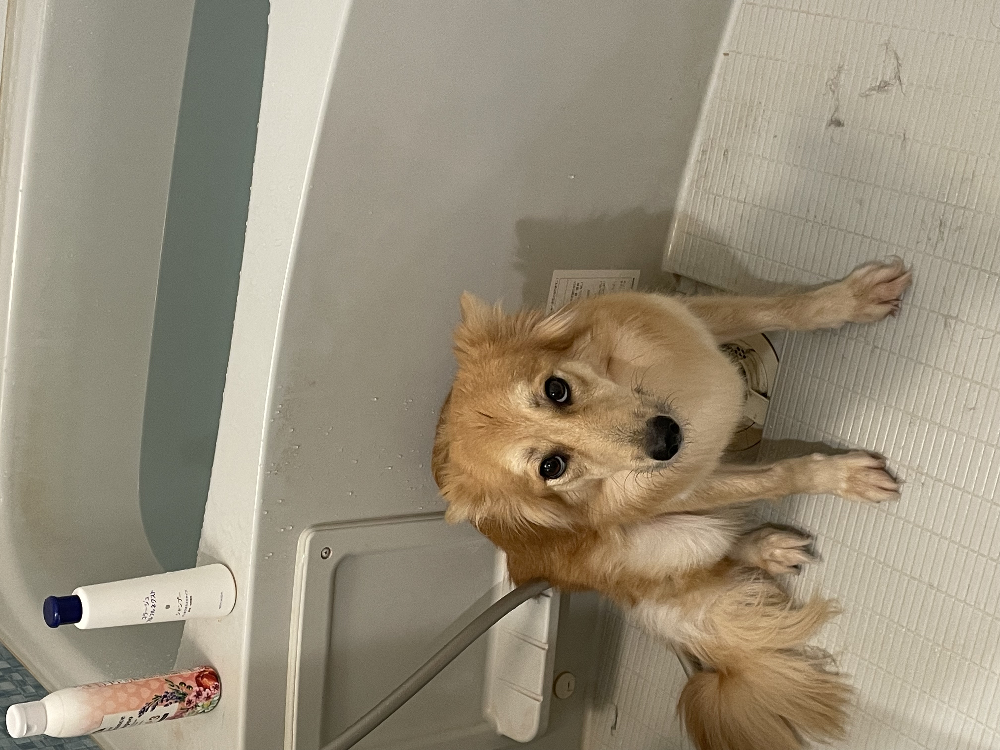

In [ ]:
from PIL import Image

vailed_image_path = './pomchan/IMG_0353.jpeg'
Image.open(vailed_image_path)

In [ ]:
ls

 __MACOSX/  'pomchan 2.zip'   rayychan.zip
 pomchan/    rayychan/        sample_data/


In [ ]:
rayy_images_train_path = './rayychan/'
pom_images_train_path = './pomchan/'
rayy_images_valid_path = './rayychan/'
pom_images_valid_path = './pomchan/'

image_and_teacher_label_list = []

import os

def get_image_teacher_label_list(dir,label):
    filepath_list = []
    files = os.listdir(dir)
    for file in files:
        filepath_list.append((dir + file, label))
    return filepath_list

image_and_teacher_label_list.extend(get_image_teacher_label_list(rayy_images_train_path, 0))
image_and_teacher_label_list.extend(get_image_teacher_label_list(pom_images_train_path, 1))
image_and_teacher_label_list.extend(get_image_teacher_label_list(rayy_images_valid_path, 0))
image_and_teacher_label_list.extend(get_image_teacher_label_list(pom_images_valid_path, 1))

print(image_and_teacher_label_list)

[('./rayychan/IMG_1640.jpeg', 0), ('./rayychan/IMG_9777.jpeg', 0), ('./rayychan/IMG_7555.jpg', 0), ('./rayychan/IMG_1318.jpeg', 0), ('./rayychan/IMG_1592.jpeg', 0), ('./rayychan/IMG_1085.jpeg', 0), ('./rayychan/IMG_9776.jpeg', 0), ('./rayychan/IMG_2058.jpeg', 0), ('./rayychan/IMG_0041.jpeg', 0), ('./rayychan/IMG_1339.jpeg', 0), ('./rayychan/IMG_1335.jpeg', 0), ('./rayychan/IMG_0026.jpeg', 0), ('./rayychan/IMG_1336.jpeg', 0), ('./rayychan/IMG_0029.jpeg', 0), ('./rayychan/IMG_1155.jpeg', 0), ('./rayychan/IMG_6887.jpg', 0), ('./rayychan/IMG_1083.jpeg', 0), ('./rayychan/IMG_1645.jpeg', 0), ('./rayychan/IMG_7396.jpg', 0), ('./rayychan/IMG_0960.jpeg', 0), ('./rayychan/IMG_2269.jpeg', 0), ('./rayychan/IMG_0436.jpeg', 0), ('./rayychan/IMG_9770.jpeg', 0), ('./rayychan/IMG_9251.JPG', 0), ('./rayychan/IMG_1641.jpeg', 0), ('./rayychan/IMG_1154.jpeg', 0), ('./rayychan/IMG_1639.jpeg', 0), ('./rayychan/IMG_0027.jpeg', 0), ('./rayychan/IMG_1094.jpeg', 0), ('./rayychan/IMG_1086.jpeg', 0), ('./rayychan/

In [ ]:
def data_reshape(width_height_channel_image):
    image_array = np.array(width_height_channel_image)
    return image_array.transpose(2,0,1)

INPUT_WIDTH = 128
INPUT_HEIGHT = 128

import cv2

image_before_reshape = cv2.imread('./rayychan/IMG_7395.jpg')
print(image_before_reshape.shape)

image_after_reshape = data_reshape(image_before_reshape)
print(image_after_reshape.shape)

(1234, 828, 3)
(3, 1234, 828)


In [ ]:
def adapt_data_to_convolution2d_format(input_image):
    image, label = input_image

    image = image.astype(np.uint8)
    image = Image.fromarray(image.transpose(1, 2, 0))
    result_image = image.resize((INPUT_WIDTH, INPUT_HEIGHT), Image.LANCZOS)
    image = data_reshape(result_image)
    image = image.astype(np.float32) / 255

    return image, label

In [ ]:
from chainer.datasets import LabeledImageDataset

pomrayy_dataset = LabeledImageDataset(image_and_teacher_label_list)

from chainer.datasets import TransformDataset
transformed_dataset = TransformDataset(pomrayy_dataset, adapt_data_to_convolution2d_format)

In [ ]:
from chainer import datasets
train_data, test_data = datasets.split_dataset_random(transformed_dataset, int(len(transformed_dataset)*0.8), seed=0)

In [ ]:
from chainer.iterators import SerialIterator

gpu_id = 0
BATCH_SIZE = 32
MAX_EPOCH = 5 

train_iter = SerialIterator(train_data, BATCH_SIZE, repeat=True, shuffle=True)
test_iter = SerialIterator(test_data, BATCH_SIZE, shuffle=False, repeat=False)

In [ ]:
print(int(len(transformed_dataset) * 0.8))
print(len(train_data))
print(len(test_data))
print(train_data)


169
169
43


In [ ]:
class MLP(Chain):
    def __init__(self):
        super().__init__()

        with self.init_scope():
            self.conv1 = L.Convolution2D(None, out_channels=32, ksize=3, stride=1, pad=1)
            self.conv2 = L.Convolution2D(in_channels=32, out_channels=64, ksize=3, stride=1, pad=1)
            self.conv3 = L.Convolution2D(in_channels=64, out_channels=128, ksize=3, stride=1, pad=1)
            self.conv4 = L.Convolution2D(in_channels=128, out_channels=256, ksize=3, stride=1, pad=1) 
            self.layer1 = L.Linear(None, 1000)
            self.layer2 = L.Linear(1000, 2)

    #
    def __call__(self, input):
        func = F.max_pooling_2d(F.relu(self.conv1(input)), ksize=2, stride=2)
        func = F.max_pooling_2d(F.relu(self.conv2(func)), ksize=2, stride=2)
        func = F.max_pooling_2d(F.relu(self.conv3(func)), ksize=2, stride=2)
        func = F.max_pooling_2d(F.relu(self.conv4(func)), ksize=2, stride=2)
        func = F.dropout(F.relu(self.layer1(func)))
        func = self.layer2(func)
        return func

mlp = MLP()

In [ ]:
model = L.Classifier(MLP())

In [ ]:
from chainer import optimizers
from chainer import training
optimizer = chainer.optimizers.SGD(lr=0.01)
optimizer.setup(model)
updater = training.StandardUpdater(train_iter, optimizer)
trainer = training.Trainer(updater, (30,'epoch'))

In [ ]:
updater = training.StandardUpdater(train_iter, optimizer)

In [ ]:
trainer = training.Trainer(updater, (30,'epoch'), out='result')

In [ ]:
trainer.run()

In [ ]:
ls

 __MACOSX/  'pomchan 2.zip'   rayychan.zip   sample_data/
 pomchan/    rayychan/        result/


In [ ]:
serializers.save_hdf5("chainer-pomrayy-model.h5", model)

In [ ]:
ls

 chainer-pomrayy-model.h5   pomchan/         rayychan/      result/
 __MACOSX/                 'pomchan 2.zip'   rayychan.zip   sample_data/


In [ ]:
def convert_test_data(image_file_path, size, show=False):
    image = Image.open(image_file_path)

    result_image = image.resize((INPUT_WIDTH, INPUT_HEIGHT), Image.LANCZOS)
    image = data_reshape(result_image)
    kekka = image.astype(np.float32)
    kekka = model.xp.asarray(kekka)
    kekka = kekka[None, ...]
    return kekka

In [ ]:
ls './rayychan/IMG_7401.jpg'


./rayychan/IMG_7401.jpg


In [ ]:
INPUT_WIDTH = 128
INPUT_HEIGHT = 128

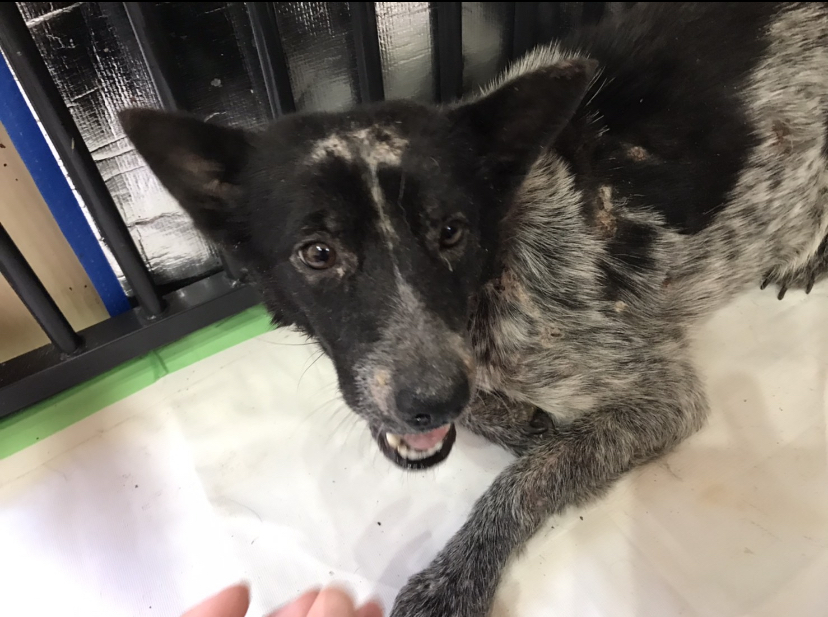

In [ ]:
test_image_url = './rayychan/IMG_7401.jpg'

from PIL import Image
import numpy as np

image_path = test_image_url
Image.open(image_path)

In [ ]:
from chainer.cuda import to_cpu

In [ ]:
test_data = convert_test_data(test_image_url, (INPUT_WIDTH, INPUT_HEIGHT))
with chainer.using_config('train', False), chainer.using_config('enable_backprop', False):
    test_teacher_labels = model.predictor(test_data)
    test_teacher_labels = to_cpu(test_teacher_labels.array)
    test_teacher_label = test_teacher_labels.argmax(axis=1)[0]
    if test_teacher_label == 0:
        retval = 'this is ray'
    else:
        retval = 'this is pom'
print(retval)

this is ray


In [ ]:
from google.colab import files
uploaded_file = files.upload()

Saving IMG_8494.jpeg to IMG_8494.jpeg


In [ ]:
ls 'IMG_8494.jpeg'

IMG_8494.jpeg


In [ ]:
INPUT_WIDTH = 128
INPUT_HEIGHT = 128

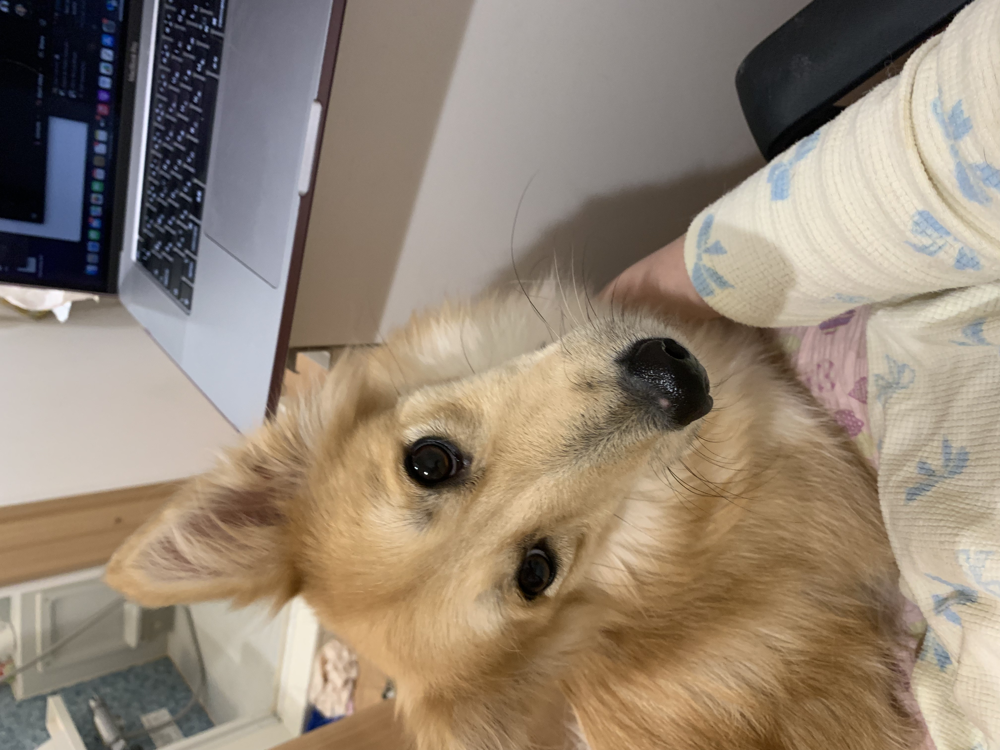

In [ ]:
test_image_url2 = 'IMG_8494.jpeg'

from PIL import Image
import numpy as np

image_path = test_image_url2
Image.open(image_path)

In [ ]:
from chainer.cuda import to_cpu

In [ ]:
test_data = convert_test_data(test_image_url2, (INPUT_WIDTH, INPUT_HEIGHT))
with chainer.using_config('train', False), chainer.using_config('enable_backprop', False):
    test_teacher_labels = model.predictor(test_data)
    test_teacher_labels = to_cpu(test_teacher_labels.array)
    test_teacher_label = test_teacher_labels.argmax(axis=1)[0]
    if test_teacher_label == 0:
        retval = 'this is ray'
    else:
        retval = 'this is pom'
print(retval)

this is pom
